# Showcase. Cool augmentation examples on diverse set of images from various real-world tasks.

## Import libraries and define helper functions

### Import the required libraries

In [ ]:
import os

import albumentations as A
import cv2
import numpy as np
from matplotlib import pyplot as plt
from skimage.color import label2rgb

### Define visualization functions

In [ ]:
BOX_COLOR = (255, 0, 0)  # Red
TEXT_COLOR = (255, 255, 255)  # White


def visualize_bbox(img, bbox, color=BOX_COLOR, thickness=2, **kwargs):
    x_min, y_min, w, h = bbox
    x_min, x_max, y_min, y_max = int(x_min), int(x_min + w), int(y_min), int(y_min + h)
    cv2.rectangle(img, (x_min, y_min), (x_max, y_max), color=color, thickness=thickness)
    return img


def visualize_titles(img, bbox, title, font_thickness=2, font_scale=0.35, **kwargs):
    x_min, y_min = bbox[:2]
    x_min = int(x_min)
    y_min = int(y_min)
    ((text_width, text_height), _) = cv2.getTextSize(title, cv2.FONT_HERSHEY_SIMPLEX, font_scale, font_thickness)
    cv2.rectangle(img, (x_min, y_min - int(1.3 * text_height)), (x_min + text_width, y_min), BOX_COLOR, -1)
    cv2.putText(
        img,
        title,
        (x_min, y_min - int(0.3 * text_height)),
        cv2.FONT_HERSHEY_SIMPLEX,
        font_scale,
        TEXT_COLOR,
        font_thickness,
        lineType=cv2.LINE_AA,
    )
    return img


def augment_and_show(
    aug,
    image,
    mask=None,
    bboxes=[],
    categories=[],
    category_id_to_name=[],
    filename=None,
    font_scale_orig=0.35,
    font_scale_aug=0.35,
    show_title=True,
    **kwargs,
):
    if mask is None:
        augmented = aug(image=image, bboxes=bboxes, category_ids=categories)
    else:
        augmented = aug(image=image, mask=mask, bboxes=bboxes, category_ids=categories)

    image_aug = augmented["image"]

    for bbox in bboxes:
        visualize_bbox(image, bbox, **kwargs)

    for bbox in augmented["bboxes"]:
        visualize_bbox(image_aug, bbox, **kwargs)

    if show_title:
        for bbox, cat_id in zip(bboxes, categories):
            visualize_titles(image, bbox, category_id_to_name[cat_id], font_scale=font_scale_orig, **kwargs)
        for bbox, cat_id in zip(augmented["bboxes"], augmented["category_ids"]):
            visualize_titles(image_aug, bbox, category_id_to_name[cat_id], font_scale=font_scale_aug, **kwargs)

    if mask is None:
        f, ax = plt.subplots(1, 2, figsize=(16, 8))

        ax[0].imshow(image)
        ax[0].set_title("Original image")

        ax[1].imshow(image_aug)
        ax[1].set_title("Augmented image")
    else:
        f, ax = plt.subplots(2, 2, figsize=(16, 16))

        if len(mask.shape) != 3:
            mask = label2rgb(mask, bg_label=0)
            mask_aug = label2rgb(augmented["mask"], bg_label=0)
        else:
            mask_aug = augmented["mask"]

        ax[0, 0].imshow(image)
        ax[0, 0].set_title("Original image")

        ax[0, 1].imshow(image_aug)
        ax[0, 1].set_title("Augmented image")

        ax[1, 0].imshow(mask, interpolation="nearest")
        ax[1, 0].set_title("Original mask")

        ax[1, 1].imshow(mask_aug, interpolation="nearest")
        ax[1, 1].set_title("Augmented mask")

    f.tight_layout()

    if filename is not None:
        f.savefig(filename)

    if mask is None:
        return augmented["image"], None, augmented["bboxes"]

    return augmented["image"], augmented["mask"], augmented["bboxes"]


def find_in_dir(dirname):
    return [os.path.join(dirname, fname) for fname in sorted(os.listdir(dirname))]

## Color augmentations

In [ ]:
image = cv2.imread("images/parrot.jpg", cv2.IMREAD_COLOR_RGB)

In [ ]:
bbox_params = A.BboxParams(format="coco", label_fields=["category_ids"])

light = A.Compose(
    [
        A.RandomBrightnessContrast(p=1),
        A.RandomGamma(p=1),
        A.CLAHE(p=1),
    ],
    p=1,
    bbox_params=bbox_params,
    strict=True,
    seed=137,
)

medium = A.Compose(
    [
        A.CLAHE(p=1),
        A.HueSaturationValue(hue_shift_limit=20, sat_shift_limit=50, val_shift_limit=50, p=1),
    ],
    p=1,
    bbox_params=bbox_params,
    strict=True,
    seed=137,
)


strong = A.Compose(
    [
        A.RGBShift(p=1),
        A.Blur(p=1),
        A.GaussNoise(p=1),
        A.ElasticTransform(p=1),
    ],
    p=1,
    bbox_params=bbox_params,
    strict=True,
    seed=137,
)

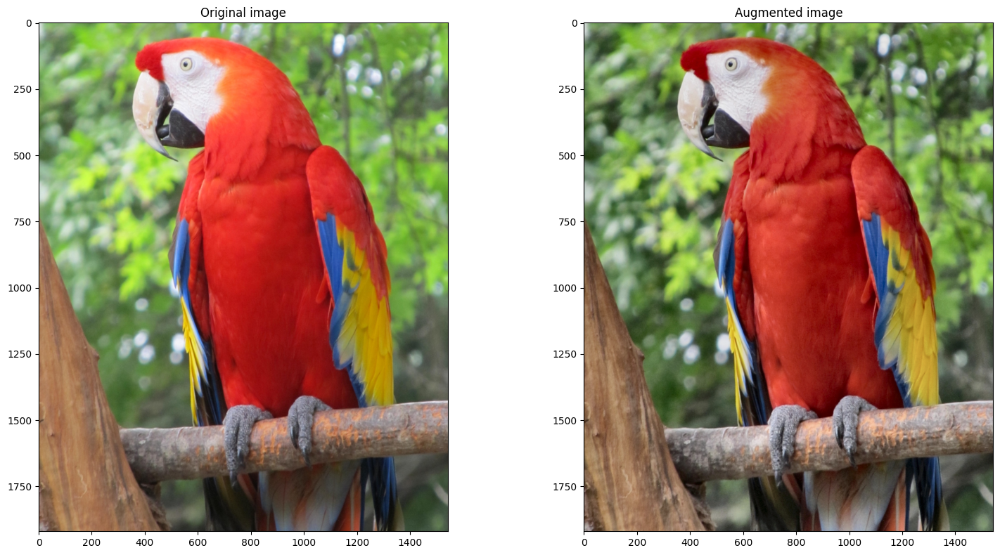

In [ ]:
r = augment_and_show(light, image)

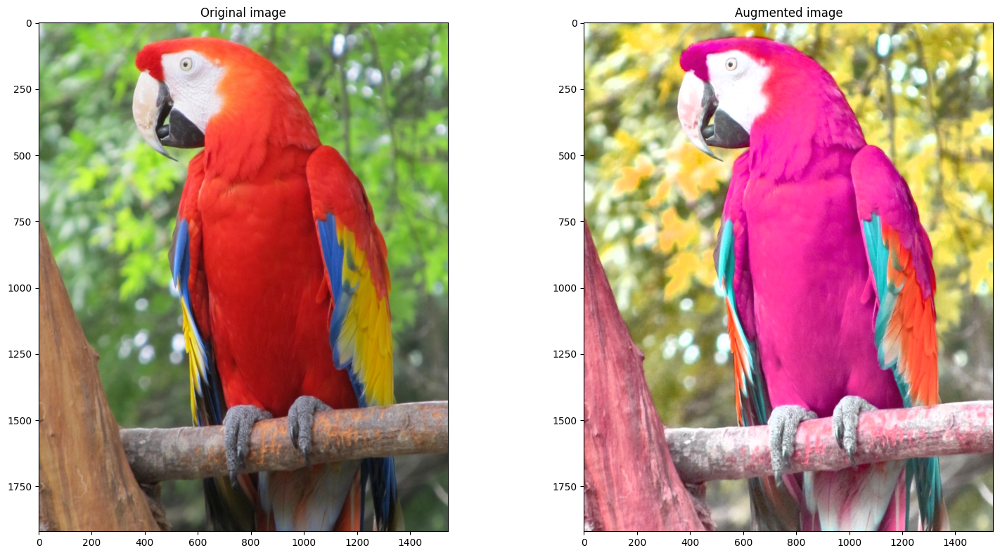

In [ ]:
r = augment_and_show(medium, image)

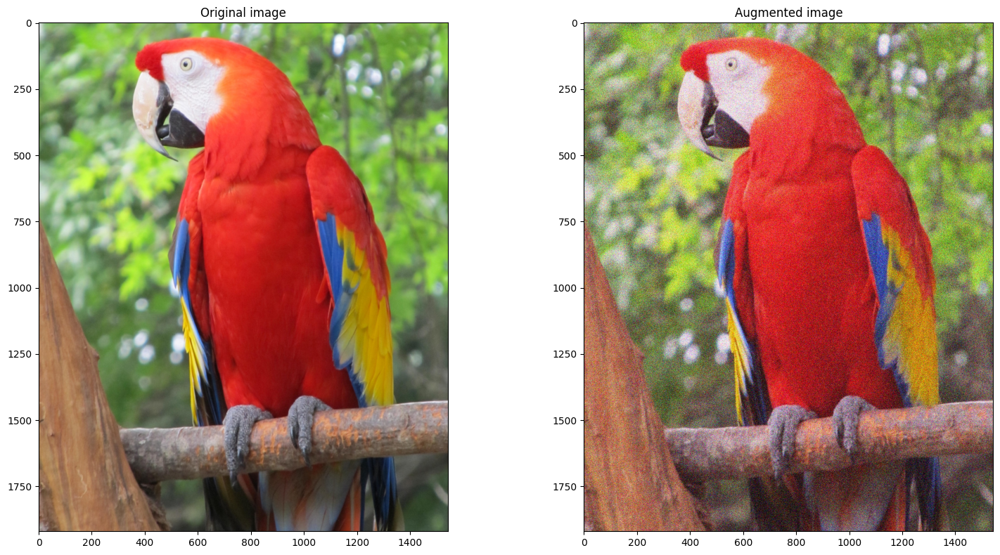

In [ ]:
r = augment_and_show(strong, image)

# Inria Aerial Image Labeling Dataset

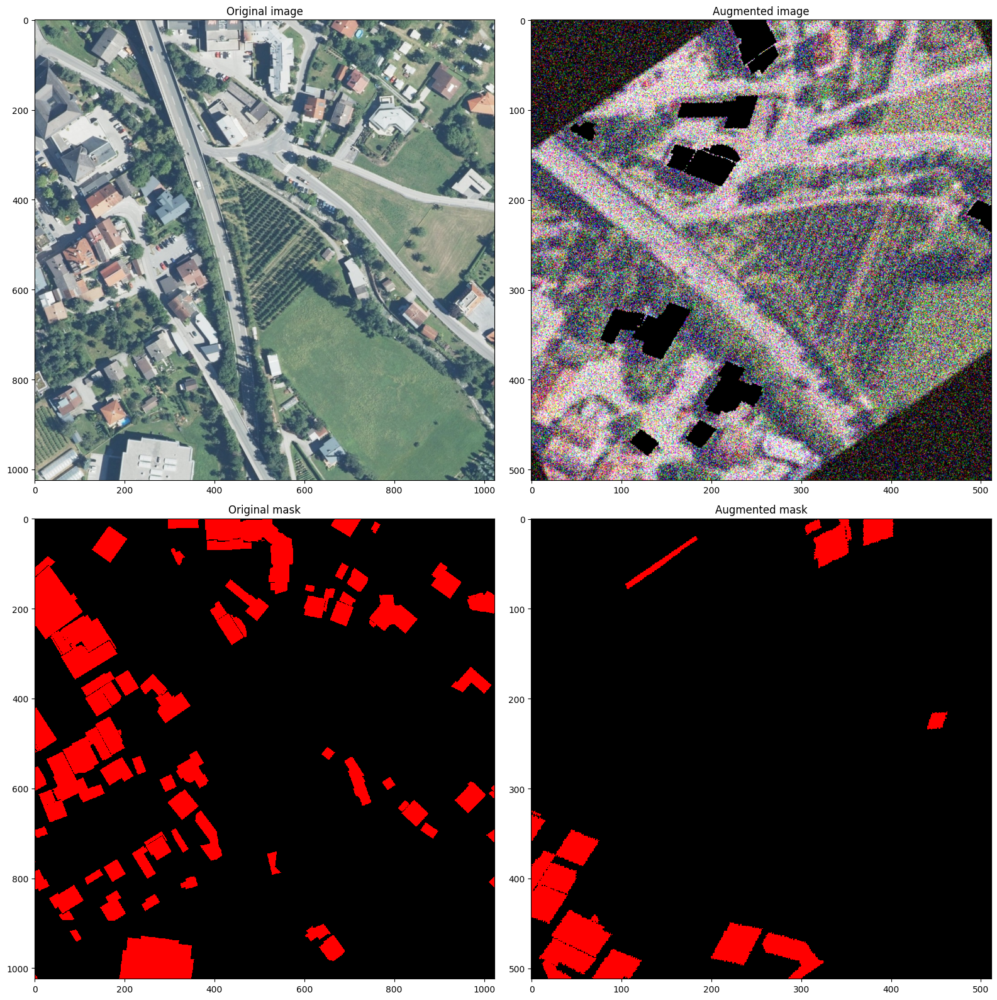

In [ ]:
image, mask = (
    cv2.imread("images/inria/inria_tyrol_w4_image.jpg", cv2.IMREAD_COLOR_RGB),
    cv2.imread("images/inria/inria_tyrol_w4_mask.tif", cv2.IMREAD_GRAYSCALE),
)
image, mask = image[:1024, :1024], mask[:1024, :1024]

light = A.Compose(
    [
        A.RandomSizedCrop((760 - 100, 760 + 100), size=(512, 512)),
        A.Affine(scale=1.1, shear=10, rotate=30),
        A.RGBShift(),
        A.Blur(),
        A.GaussNoise(),
        A.ElasticTransform(),
        A.MaskDropout((10, 15), p=1),
    ],
    p=1,
    bbox_params=A.BboxParams(format="coco", label_fields=["category_ids"]),
    strict=True,
    seed=137,
)

r = augment_and_show(light, image, mask)

# 2018 Data Science Bowl

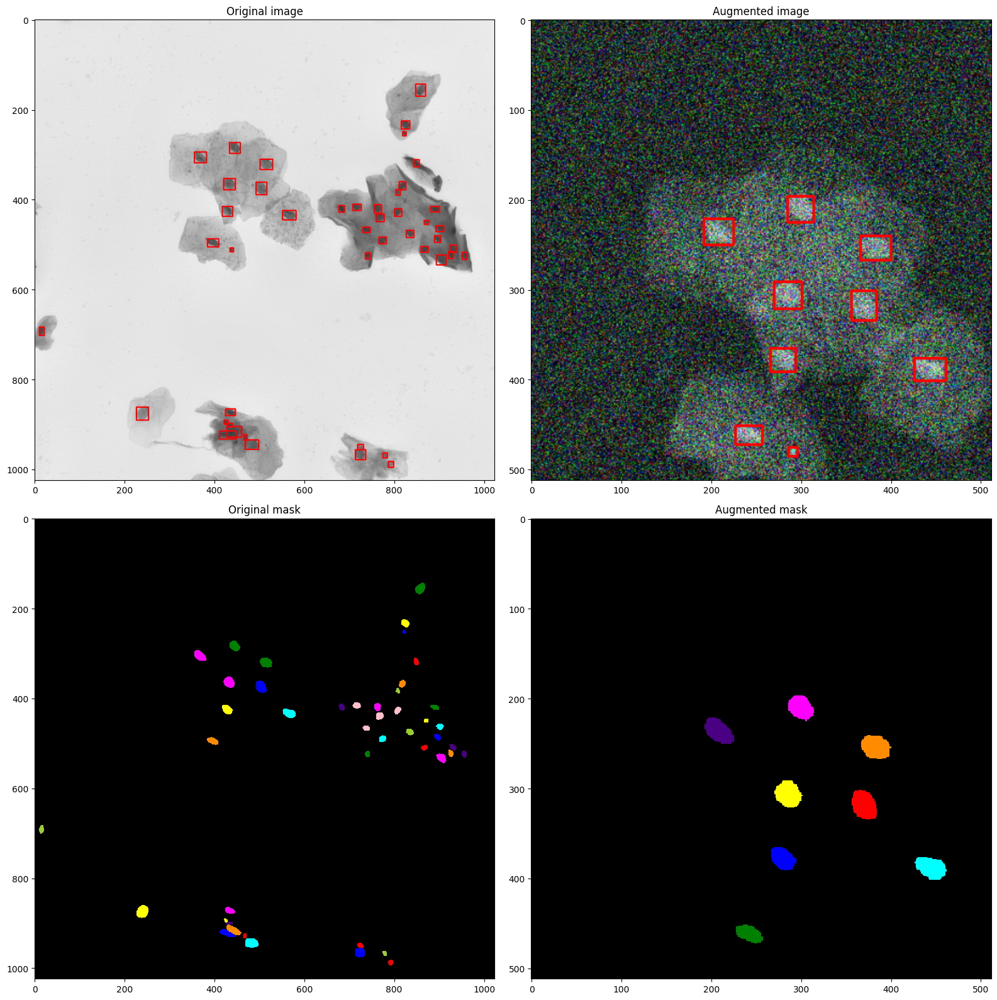

In [ ]:
image = cv2.imread(
    "images/dsb2018/1a11552569160f0b1ea10bedbd628ce6c14f29edec5092034c2309c556df833e/images/1a11552569160f0b1ea10bedbd628ce6c14f29edec5092034c2309c556df833e.png",
)
masks = [
    cv2.imread(x, cv2.IMREAD_GRAYSCALE)
    for x in find_in_dir("images/dsb2018/1a11552569160f0b1ea10bedbd628ce6c14f29edec5092034c2309c556df833e/masks")
]
bboxes = [cv2.boundingRect(cv2.findNonZero(mask)) for mask in masks]
label_image = np.zeros_like(masks[0])
for i, mask in enumerate(masks):
    label_image += (mask > 0).astype(np.uint8) * i

light = A.Compose(
    [
        A.RGBShift(),
        A.InvertImg(),
        A.Blur(),
        A.GaussNoise(),
        A.RandomRotate90(),
        A.RandomSizedCrop((512 - 100, 512 + 100), size=(512, 512)),
    ],
    bbox_params={"format": "coco", "min_area": 1, "min_visibility": 0.5, "label_fields": ["category_ids"]},
    p=1,
    strict=True,
    seed=137,
)

label_ids = [0] * len(bboxes)
label_names = ["Nuclei"]

r = augment_and_show(light, image, label_image, bboxes, label_ids, label_names, show_title=False)

# Mapilary Vistas

In [ ]:
from PIL import Image

image = cv2.imread("images/vistas/_HnWguqEbRCphUquTMrCCA.jpg", cv2.IMREAD_COLOR_RGB)
labels = cv2.imread("images/vistas/_HnWguqEbRCphUquTMrCCA_labels.png", cv2.IMREAD_COLOR_RGB)
instances = np.array(Image.open("images/vistas/_HnWguqEbRCphUquTMrCCA_instances.png"), dtype=np.uint16)
IGNORED = 65 * 256

instances[(instances // 256 != 55) & (instances // 256 != 44) & (instances // 256 != 50)] = IGNORED

image = image[1000:2500, 1000:2500]
labels = labels[1000:2500, 1000:2500]
instances = instances[1000:2500, 1000:2500]

bboxes = [
    cv2.boundingRect(cv2.findNonZero((instances == instance_id).astype(np.uint8)))
    for instance_id in np.unique(instances)
    if instance_id != IGNORED
]
instance_labels = [instance_id // 256 for instance_id in np.unique(instances) if instance_id != IGNORED]

titles = [
    "Bird",
    "Ground Animal",
    "Curb",
    "Fence",
    "Guard Rail",
    "Barrier",
    "Wall",
    "Bike Lane",
    "Crosswalk - Plain",
    "Curb Cut",
    "Parking",
    "Pedestrian Area",
    "Rail Track",
    "Road",
    "Service Lane",
    "Sidewalk",
    "Bridge",
    "Building",
    "Tunnel",
    "Person",
    "Bicyclist",
    "Motorcyclist",
    "Other Rider",
    "Lane Marking - Crosswalk",
    "Lane Marking - General",
    "Mountain",
    "Sand",
    "Sky",
    "Snow",
    "Terrain",
    "Vegetation",
    "Water",
    "Banner",
    "Bench",
    "Bike Rack",
    "Billboard",
    "Catch Basin",
    "CCTV Camera",
    "Fire Hydrant",
    "Junction Box",
    "Mailbox",
    "Manhole",
    "Phone Booth",
    "Pothole",
    "Street Light",
    "Pole",
    "Traffic Sign Frame",
    "Utility Pole",
    "Traffic Light",
    "Traffic Sign (Back)",
    "Traffic Sign (Front)",
    "Trash Can",
    "Bicycle",
    "Boat",
    "Bus",
    "Car",
    "Caravan",
    "Motorcycle",
    "On Rails",
    "Other Vehicle",
    "Trailer",
    "Truck",
    "Wheeled Slow",
    "Car Mount",
    "Ego Vehicle",
    "Unlabeled",
]
bbox_params = A.BboxParams(format="coco", min_area=1, min_visibility=0.5, label_fields=["category_ids"])

light = A.Compose(
    [
        A.HorizontalFlip(p=1),
        A.RandomSizedCrop((800 - 100, 800 + 100), size=(600, 600)),
        A.GaussNoise(p=1),
    ],
    bbox_params=bbox_params,
    p=1,
    strict=True,
    seed=137,
)

medium = A.Compose(
    [
        A.HorizontalFlip(p=1),
        A.RandomSizedCrop((800 - 100, 800 + 100), size=(600, 600)),
        A.MotionBlur(blur_limit=17, p=1),
    ],
    bbox_params=bbox_params,
    p=1,
    strict=True,
    seed=137,
)


strong = A.Compose(
    [
        A.HorizontalFlip(p=1),
        A.RandomSizedCrop((800 - 100, 800 + 100), size=(600, 600)),
        A.RGBShift(p=1),
        A.Blur(blur_limit=11, p=1),
        A.RandomBrightnessContrast(p=1),
        A.CLAHE(p=1),
    ],
    bbox_params=bbox_params,
    p=1,
    strict=True,
    seed=137,
)

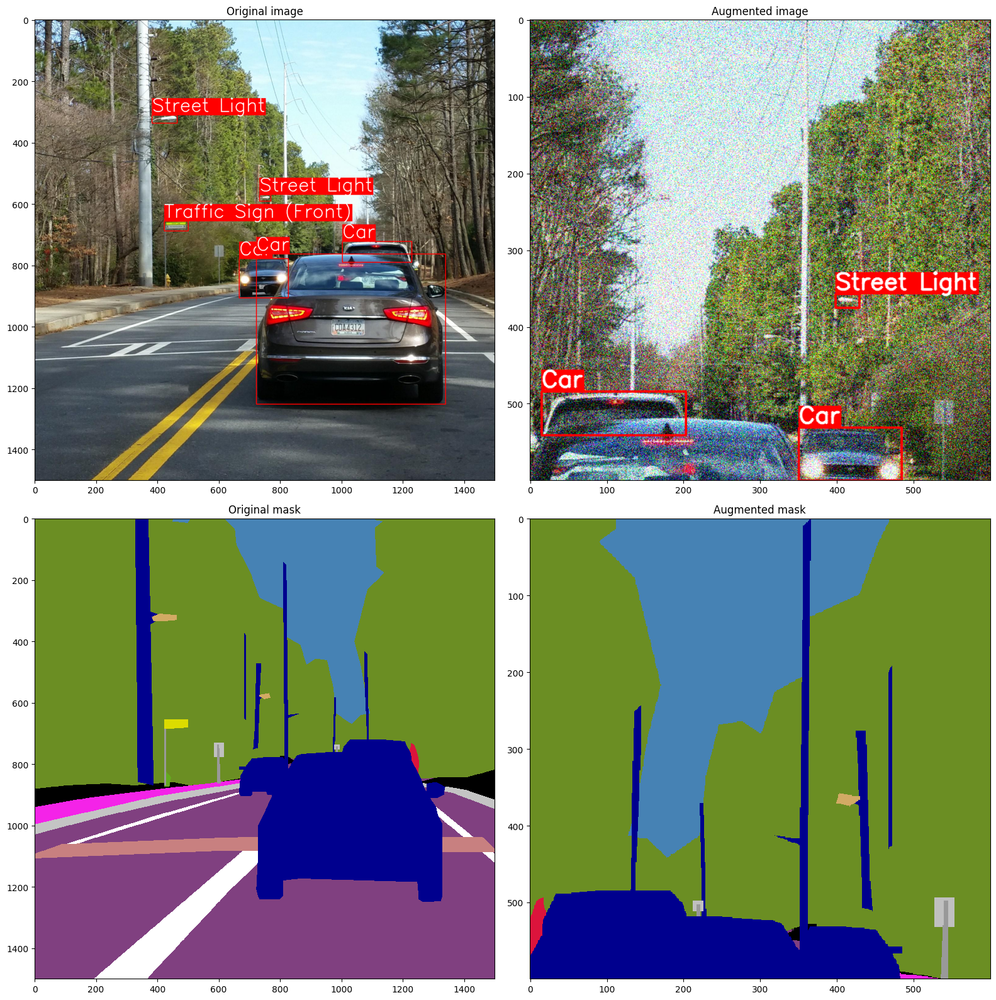

In [ ]:
r = augment_and_show(
    light,
    image,
    labels,
    bboxes,
    instance_labels,
    titles,
    thickness=2,
    font_scale_orig=2,
    font_scale_aug=1,
)

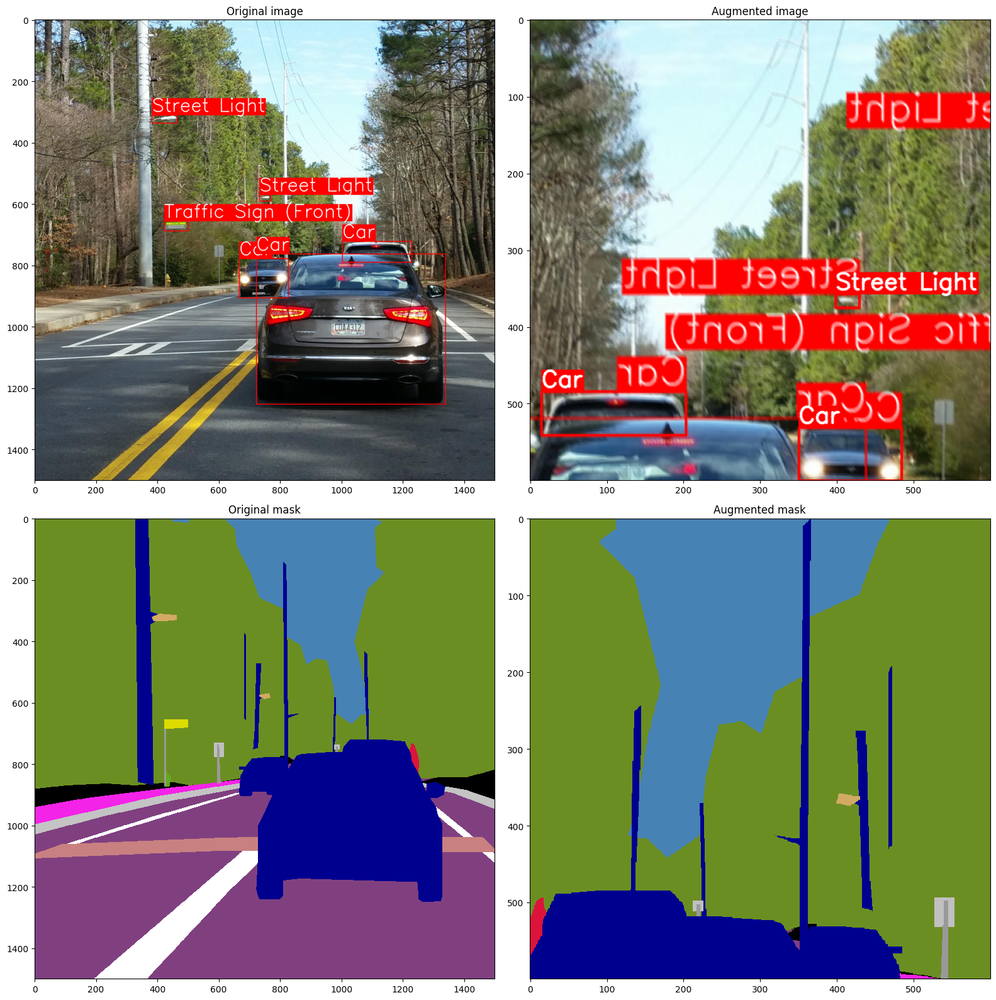

In [ ]:
r = augment_and_show(
    medium,
    image,
    labels,
    bboxes,
    instance_labels,
    titles,
    thickness=2,
    font_scale_orig=2,
    font_scale_aug=1,
)

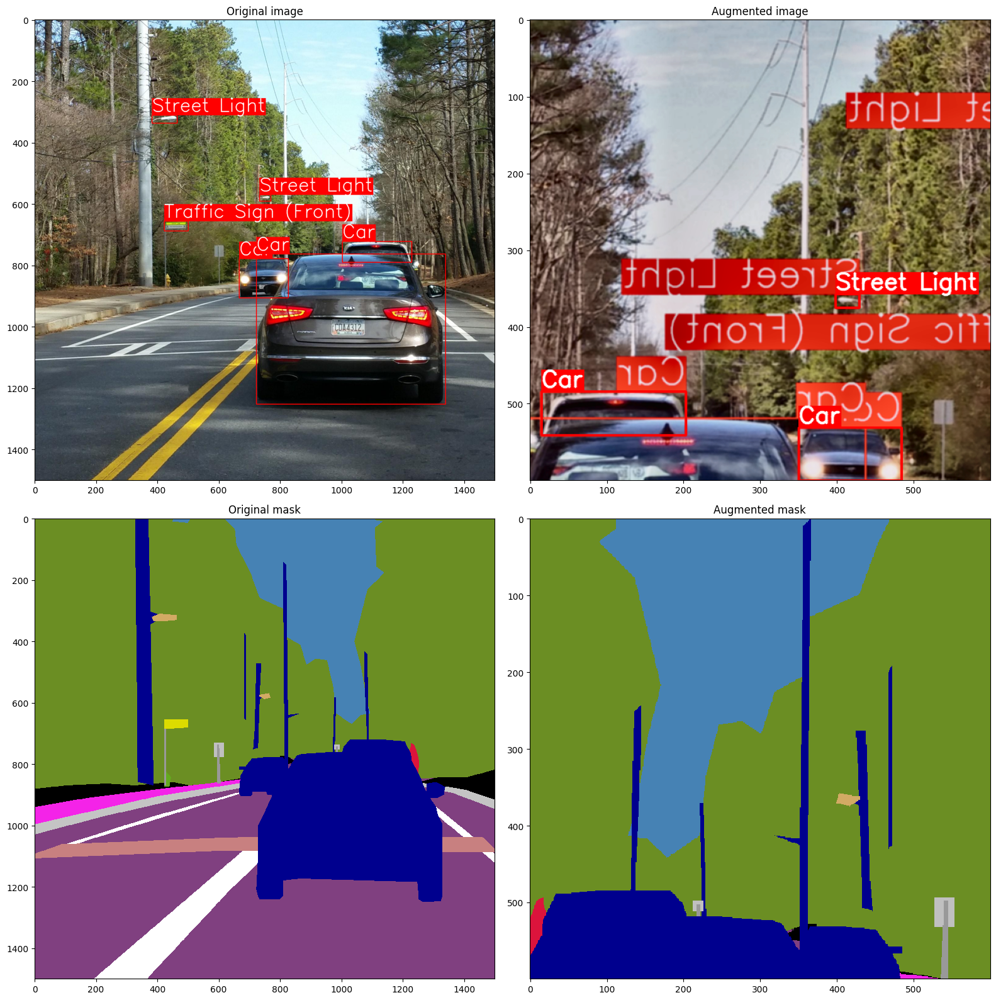

In [ ]:
r = augment_and_show(
    strong,
    image,
    labels,
    bboxes,
    instance_labels,
    titles,
    thickness=2,
    font_scale_orig=2,
    font_scale_aug=1,
)